In [ ]:
import os
import cv2
import shutil
import torch
import torchvision
from torchvision.models.detection import KeypointRCNN
from torchvision.models.detection.anchor_utils import AnchorGenerator
import numpy as np
import pandas as pd
from PIL import Image
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torch.distributed as dist

In [ ]:
torch.manual_seed(22);

In [ ]:
from google.colab import files

files.upload() #animals_data.zip

Saving animals_data.zip to animals_data.zip


In [ ]:
data_dir = '/content/data'

In [ ]:
shutil.unpack_archive('/content/animals_data.zip', data_dir)

In [ ]:
def features_to_dict(features):
    target_dict = dict()

    target_dict['boxes'] = torch.FloatTensor([[features[5], features[6], features[5] + features[7], features[6] + features[8]]])
    target_dict['labels'] = torch.IntTensor([features[:5].argmax() + 1]).long()
    keypoints_list = list()
    for i in range(9, 67, 3):
      keypoints_list.append([features[i+1], features[i+2], features[i]])

    target_dict['keypoints'] = torch.FloatTensor([keypoints_list])

    return target_dict

In [ ]:
class AnimalsDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None):
        self.data = csv_file
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_idx = self.data.iloc[idx, 0]
        img_name = os.path.join(self.root_dir, "0"*(3-len(str(img_idx))) + str(img_idx) + ".jpeg")
        image = Image.open(img_name)
        features = self.data.iloc[idx, 1:].to_numpy()

        if self.transform:
            image = self.transform(image)

        sample = (image, features_to_dict(features))

        return sample

In [ ]:
target_size = (256, 256)

In [ ]:
train_transforms = transforms.Compose([
        transforms.Resize(target_size),
        transforms.ToTensor()
])

df = pd.read_csv(os.path.join(data_dir, 'animals_data.csv'))


# Костыль для скейла данных к target_size
df_dict = df.to_dict()

for column in df.columns:
    if '_x' in column or '_width' in column or '_y' in column or '_height' in column:
        df[column] = df[column].astype(float)

for idx in df_dict['id'].values():
    img_name = os.path.join(data_dir, 'animals', "0"*(3-len(str(idx))) + str(idx) + ".jpeg")
    image = Image.open(img_name)
    x_size, y_size = image.size
    for column in df_dict.keys():
        if '_x' in column or '_width' in column:
            df_dict[column][idx] *= target_size[0]
            df_dict[column][idx] //= x_size
        elif '_y' in column or '_height' in column:
            df_dict[column][idx] *= target_size[1]
            df_dict[column][idx] //= y_size

df = pd.DataFrame.from_dict(df_dict)

dataset = AnimalsDataset(csv_file=df, root_dir=os.path.join(data_dir, 'animals'), transform=train_transforms)

print(f"Экземпляров в датасете: {len(dataset)}")

Экземпляров в датасете: 967


In [ ]:
train_set, val_set = torch.utils.data.random_split(dataset, [966, 1])

batch_size = 5
num_workers = 0

train_dataloader = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_dataloader = DataLoader(val_set, batch_size=batch_size, shuffle=True, num_workers=num_workers)

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Device:", device)

Device: cuda:0


In [ ]:
# backbone = torchvision.models.mobilenet_v2(pretrained=True).features
# backbone.out_channels = 1280

# backbone = torchvision.models.mobilenet_v3_small(pretrained=True).features
# backbone.out_channels = 576

backbone = torchvision.models.mobilenet_v3_large(pretrained=True).features
backbone.out_channels = 960

anchor_generator = AnchorGenerator(sizes=((16, 32, 64, 128, 256),), aspect_ratios=((0.5, 1.0, 2.0),))

roi_pooler = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'], output_size=7, sampling_ratio=2)
keypoint_roi_pooler = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'], output_size=14, sampling_ratio=2)

model = KeypointRCNN(backbone, num_classes=6, num_keypoints=20,
                     rpn_anchor_generator=anchor_generator,
                     box_roi_pool=roi_pooler, keypoint_roi_pool=keypoint_roi_pooler)

model = model.to(device)

params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, amsgrad=True, lr=1.0e-3)

scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

In [ ]:
def is_dist_avail_and_initialized():
    if not dist.is_available():
        return False
    if not dist.is_initialized():
        return False
    return True

def get_world_size():
    if not is_dist_avail_and_initialized():
        return 1
    return dist.get_world_size()

def reduce_dict(input_dict, average=True):
    world_size = get_world_size()
    if world_size < 2:
        return input_dict
    with torch.no_grad():
        names = []
        values = []
        for k in sorted(input_dict.keys()):
            names.append(k)
            values.append(input_dict[k])
        values = torch.stack(values, dim=0)
        dist.all_reduce(values)
        if average:
            values /= world_size
        reduced_dict = {k: v for k, v in zip(names, values)}
    return reduced_dict

In [ ]:
num_epochs = 15

loss_history = {'train':[], 'eval':[]}

for epoch in range(num_epochs):
    print()
    print('Epoch {}/{}:'.format(epoch, num_epochs - 1), flush=True)

    for phase in ['train']:
        if phase == 'train':
            dataloader = train_dataloader
            if epoch != 0:
                scheduler.step()
            model.train()
        else:
            dataloader = val_dataloader
            model.eval()

        running_loss = 0.

        for images, targets in tqdm(dataloader):
            images = images.to(device)

            targets_list = list()
            for target_idx in range(len(targets['labels'])):
                targets_list.append(dict())
                for item in targets.items():
                    targets_list[-1][item[0]] = item[1][target_idx].to(device)
            targets = targets_list

            optimizer.zero_grad()

            with torch.set_grad_enabled(phase == 'train'):
                loss_dict = model(images, targets)

                losses = sum(loss for loss in loss_dict.values())

                loss_dict_reduced = reduce_dict(loss_dict)
                losses_reduced = sum(loss for loss in loss_dict_reduced.values())

                loss_value = losses_reduced.item()

                if phase == 'train':
                    losses.backward()
                    optimizer.step()

            running_loss += loss_value
        
        epoch_loss = running_loss / len(dataloader)
        loss_history[phase].append(epoch_loss)

        print('  {} Loss: {:.4f}'.format(phase, epoch_loss), flush=True)


Epoch 0/14:


100%|██████████| 194/194 [02:57<00:00,  1.09it/s]

  train Loss: 7.2903

Epoch 1/14:



100%|██████████| 194/194 [02:59<00:00,  1.08it/s]

  train Loss: 5.5811

Epoch 2/14:



100%|██████████| 194/194 [03:01<00:00,  1.07it/s]

  train Loss: 5.0270

Epoch 3/14:



100%|██████████| 194/194 [03:04<00:00,  1.05it/s]

  train Loss: 4.4238

Epoch 4/14:



100%|██████████| 194/194 [03:04<00:00,  1.05it/s]

  train Loss: 4.2280

Epoch 5/14:



100%|██████████| 194/194 [03:04<00:00,  1.05it/s]

  train Loss: 4.1122

Epoch 6/14:



100%|██████████| 194/194 [03:02<00:00,  1.06it/s]

  train Loss: 3.9828

Epoch 7/14:



100%|██████████| 194/194 [03:02<00:00,  1.06it/s]

  train Loss: 3.9594

Epoch 8/14:



100%|██████████| 194/194 [03:02<00:00,  1.06it/s]

  train Loss: 3.9421

Epoch 9/14:



100%|██████████| 194/194 [03:03<00:00,  1.06it/s]

  train Loss: 3.9423

Epoch 10/14:



100%|██████████| 194/194 [03:03<00:00,  1.06it/s]

  train Loss: 3.9363

Epoch 11/14:



100%|██████████| 194/194 [03:03<00:00,  1.06it/s]

  train Loss: 3.9337

Epoch 12/14:



100%|██████████| 194/194 [03:03<00:00,  1.06it/s]

  train Loss: 3.9331

Epoch 13/14:



100%|██████████| 194/194 [03:02<00:00,  1.06it/s]

  train Loss: 3.9322

Epoch 14/14:



100%|██████████| 194/194 [03:02<00:00,  1.06it/s]

  train Loss: 3.9252


Best loss: 3.9252


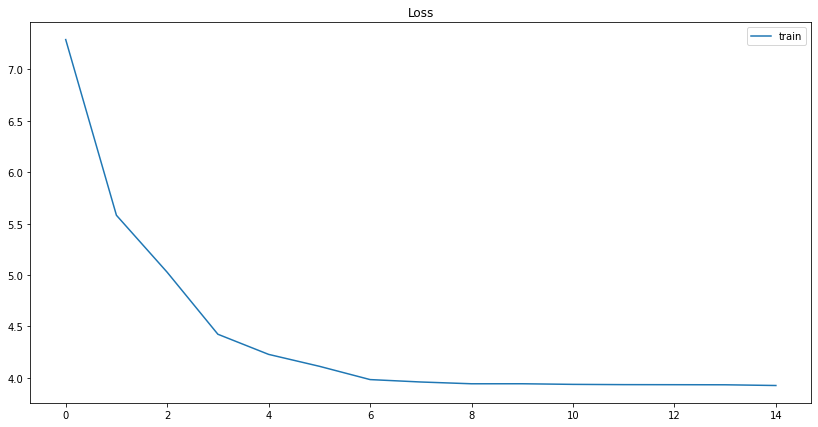

In [ ]:
plt.rcParams['figure.figsize'] = (14, 7)
plt.plot(loss_history['train'], label=phase)
plt.legend()
plt.title('Loss');
print('Best loss: {:.4f}'.format(min(loss_history['train'])))

# 4.4040 mobilenet_v2
# 3.7580 mobilenet_v3_large
# 3.9252 mobilenet_v3_small

In [ ]:
 model.eval();

In [ ]:
from google.colab import files

files.upload() #test.zip

Saving test.zip to test.zip


{'test.zip': b'PK\x03\x04\n\x00\x00\x00\x00\x00\x96\x00\x87R\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x05\x00\x00\x00test/PK\x03\x04\x14\x00\x00\x00\x08\x00\xe6\xbe\x86R\x1f\xbc\xad`7$\x04\x00[@\x04\x00\x11\x00\x00\x00test/animals1.jpg\x9c\xfdy\\\xd2\xdb\x17\xff\x8fr\x9al2*3\xcbJ:\xa9Y9P9\xa5!\x9c2#3\xa3\xd2r\x86\xcc\x94\x94\xca\xc8Lp\x80\xcfiPS\x93\x93\xa6\x94\x9a\x1c3%s sV\x94\xe3\x9c#9\x92C\xa8\xa8\xe0,\x83(\xcat\xe9\xfb\xbb\x8f\xdf\xbd\x7f\xdc?\xee\xbdo\xfd\x03\xe1\xcd\xdb\xb5\xf7^\xef\xb5\x9e\xaf\xcd\xde\x0b\xe5O\xe5(`\xe7\xe5\x8b\xf6\x17\x01\x7f\xfc\x01\x00\xfc\xa1\xfa\x01(\x87\x00\xb6\x80?\xfe\xdf\x8fu\xeb\xd6\xaf\xfb}lX\xbf~\xdd\xfa\x8d\x1b6n\xdc\xb8a\xc3\x86\x8d\x9b\xd46m\xdc\xa8\xb6i\xc3\x86M[6\xa9m\xfe}l\xdc\xb4e\xeb\x96\xcd[\x7f\xff\xf1\xfb"\xff\xd7[\xd7mP\xfdnV\xbdk\xf3\xff\xcf\x87\xf2?\xc0\xae\xcd\xebz7\xe4\xad\xff\xe3\x08`\xdd\xae?\xd6\xef\xfaC\xd9\x00\x00\xa9\xec\xdc\xf8\x7f\x19\x06\xf8\x7f\x1e\x7f\xac[\xff\xdb\x9e\xcd[\xb6n\xfb}\xc2\x1f\x80\xf5\xff\xb7\xed\xff\x

In [ ]:
test_data_dir = '/content/data/test'

shutil.unpack_archive('/content/test.zip', data_dir)

In [ ]:
test_transforms = transforms.Compose([
        transforms.Resize(target_size),
        transforms.ToTensor()
])

test_dataset = []
for img in os.listdir(test_data_dir):
  image = Image.open(os.path.join(test_data_dir, img)).convert('RGB')
  orig_numpy = np.array(image, dtype=np.float32)
  orig_numpy = cv2.cvtColor(orig_numpy, cv2.COLOR_RGB2BGR) / 255.
  image = test_transforms(image)
  image = image.unsqueeze(0).to(device)
  test_dataset.append(image[0])

In [ ]:
batch_size = len(os.listdir(test_data_dir))
num_workers = 0

test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)

In [ ]:
def draw_keypoints(output, image):
    plt.rcParams['figure.figsize'] = (5, 5)
    plt.figure()
    ax = plt.gca()

    image = image.squeeze().permute(1,2,0)
    plt.imshow(image)
    
    if len(output['scores']) > 0:
        print(output['scores'][0])
        print(output['labels'][0])

        keypoints = (output['keypoints'][0].cpu().detach().numpy())[:, :].reshape(-1, 3)
        for k in range(keypoints.shape[0]):
            if keypoints[k, 2] == 1:
                plt.scatter(int(keypoints[k, 0]), int(keypoints[k, 1]), s=100, marker='.', c='r')

        box = output['boxes'][0]

        rect_x = box[0]
        rect_y = box[1]
        rect_w = box[2] - box[0]
        rect_h = box[3] - box[1]

        rect = patches.Rectangle((rect_x, rect_y), rect_w, rect_h, linewidth=2, edgecolor='cyan', fill = False)
        ax.add_patch(rect)
    
    plt.show()
            

tensor(0.9675)
tensor(1)


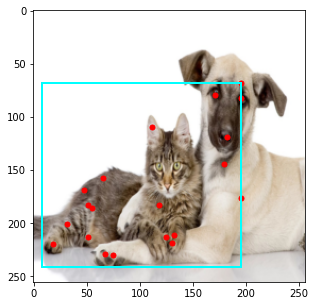

tensor(0.8302)
tensor(4)


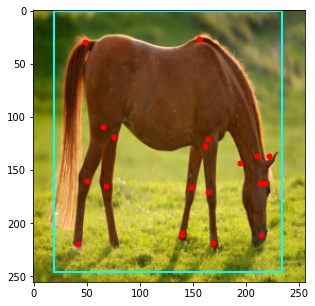

tensor(0.6941)
tensor(2)


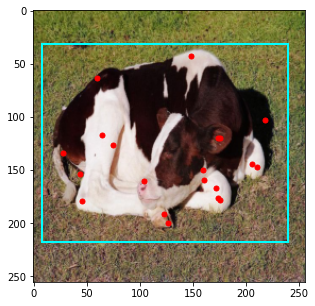

tensor(0.8708)
tensor(1)


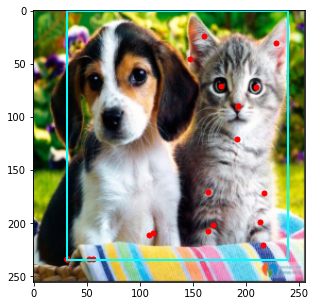

tensor(0.9240)
tensor(2)


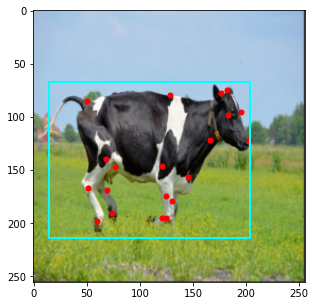

tensor(0.0840)
tensor(4)


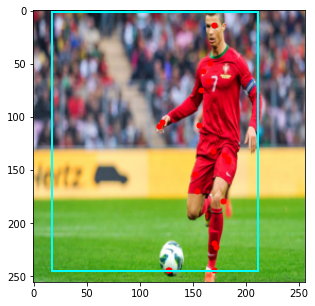

tensor(0.7896)
tensor(3)


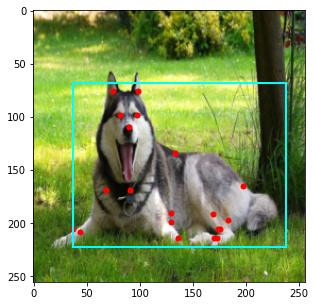

tensor(0.8256)
tensor(3)


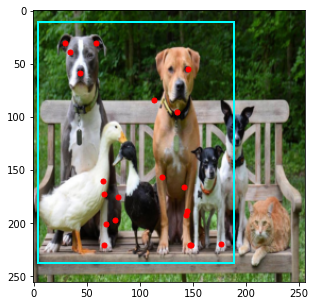

tensor(0.8581)
tensor(3)


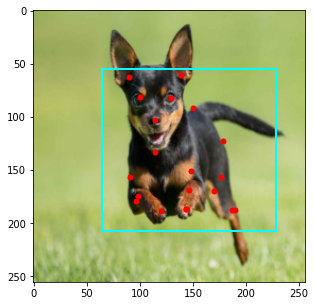

tensor(0.8681)
tensor(1)


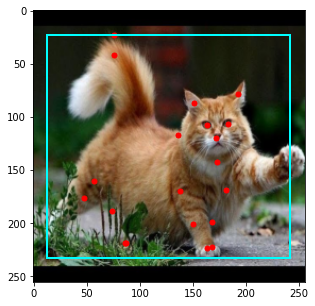

tensor(0.6587)
tensor(5)


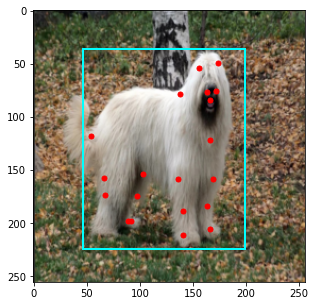

tensor(0.5778)
tensor(1)


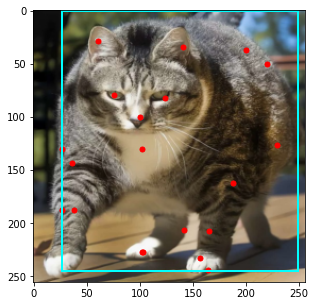

tensor(0.8717)
tensor(3)


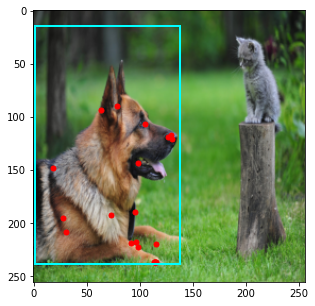

tensor(0.9304)
tensor(1)


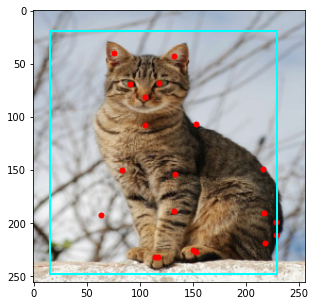

tensor(0.6957)
tensor(3)


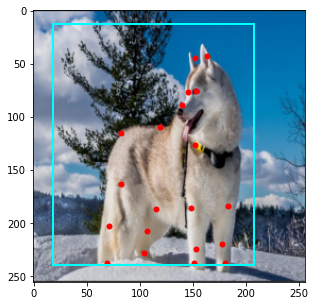

tensor(0.6352)
tensor(4)


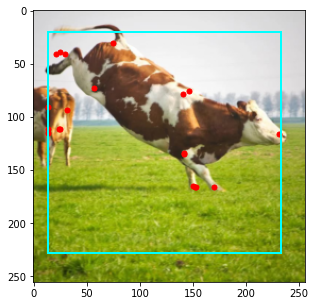

tensor(0.7987)
tensor(3)


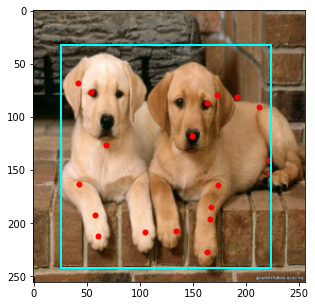

tensor(0.9547)
tensor(5)


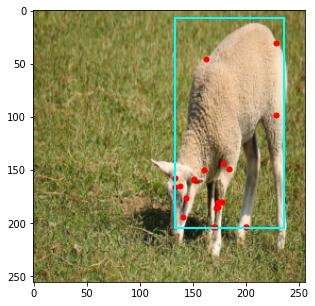

tensor(0.6301)
tensor(5)


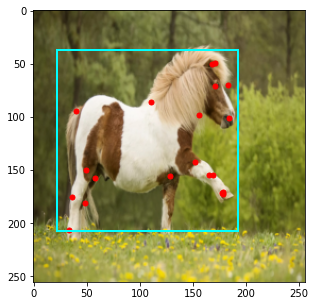

tensor(0.9842)
tensor(5)


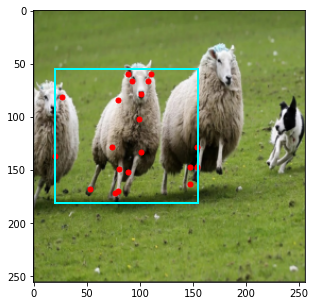

tensor(0.7697)
tensor(5)


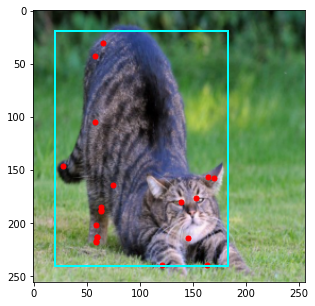

tensor(0.9473)
tensor(5)


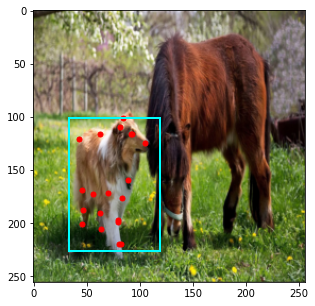

tensor(0.9484)
tensor(4)


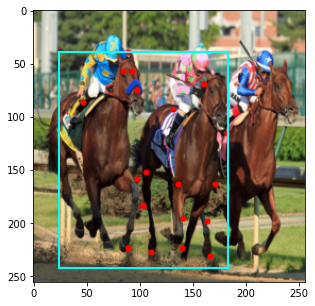

tensor(0.6316)
tensor(1)


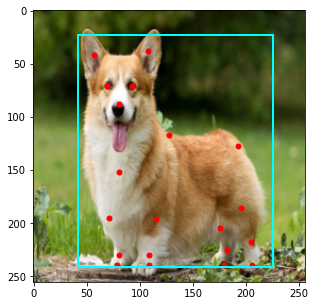

In [ ]:
for data in test_dataloader:
    inputs = data.to(device, non_blocking=True)

    with torch.no_grad():
        outputs = model(inputs)

    inputs = inputs.cpu()

    for image_idx in range(len(inputs)):
        output = outputs[image_idx]
        input = inputs[image_idx]

        for key in output.keys():
            output[key] = output[key].cpu()

        draw_keypoints(output, input)

In [ ]:
torch.save(model.state_dict(), '/content/keypointrcnn_mobilenetv3small.pth')